<a href="https://colab.research.google.com/github/hosheloiza/cp3/blob/main/CP5_database.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Segmentação de Clientes de Cartão de Crédito**

### **Analistas**:
- Ana Beatriz
- Heloiza Oliveira
- Matheus Madrid
- Sara Sitta

### **Objetivo da Análise**:
A análise de clusterização foi realizada com o objetivo de segmentar os clientes de cartão de crédito, identificando grupos com comportamentos semelhantes, para auxiliar a empresa na definição de estratégias de retenção e oferta de produtos personalizados.

### **Data**:
Outubro 2024

### **Matéria**:
Database Application e Data Science - FIAP

# Instalando biblioteca

In [ ]:
pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.0/390.0 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 17.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 31.9 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=8e1d7e49bbffba499ca2cd45861bc25c42e629677a9789184ce07f9be9502805
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


# Importando

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler, LabelEncoder
from yellowbrick.cluster import KElbowVisualizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
from matplotlib.colors import ListedColormap
import plotly.express as px

In [ ]:
# Lendo o Arquivo CSV
df = pd.read_csv('https://raw.githubusercontent.com/mthmadrid/credit_card_customer/refs/heads/main/BankChurners.csv')
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


# Verificação dos Dados

https://www.kaggle.com/datasets/thedevastator/predicting-credit-card-customer-attrition-with-m

This dataset provides customer information to predict customer attrition for a consumer credit card portfolio

######CLIENTNUM: Unique identifier for each customer. (Integer)
######Attrition_Flag: Flag indicating whether or not the customer has churned out. (Boolean)
######Customer_Age: Age of customer. (Integer)
######Gender: Gender of customer. (String)
######Dependent_count: Number of dependents that customer has. (Integer)
######Education_Level: Education level of customer. (String)
######Marital_Status: Marital status of customer. (String)
######Income_Category: Income category of customer. (String)
######Card_Category: Type of card held by customer. (String)
######Months_on_book: How long customer has been on the books. (Integer)
######Total_Relationship_Count: Total number of relationships customer has with the credit card provider. (Integer)
######Months_Inactive_12_mon: Number of months customer has been inactive in the last twelve months. (Integer)
######Contacts_Count_12_mon: Number of contacts customer has had in the last twelve months. (Integer)
######Credit_Limit: Credit limit of customer. (Integer)
######Total_Revolving_Bal: Total revolving balance of customer. (Integer)
######Avg_Open_To_Buy: Average open to buy ratio of customer. (Integer)
######Total_Amt_Chng_Q4_Q1: Total amount changed from quarter 4 to quarter 1. (Integer)
######Total_Trans_Amt: Total transaction amount. (Integer)
######Total_Trans_Ct: Total transaction count. (Integer)
######Total_Ct_Chng_Q4_Q1: Total count changed from quarter 4 to quarter 1. (Integer)
######Avg_Utilization_Ratio: Average utilization ratio of customer. (Integer)
######Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1: Naive Bayes classifier for predicting whether or not someone will churn based on characteristics such


In [ ]:
# Analisando o nome das colunas
df.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
      dtype='object')

In [ ]:
# Analisando o número de linhas e colunas
df.shape

(10127, 23)

In [ ]:
# Verificando
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           

In [ ]:
# Renomeando as colunas
df = df.rename(columns={
    'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1': 'Naive_Bayes_1',
    'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2': 'Naive_Bayes_2'
})
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

In [ ]:
# Verificando os valores únicos para cada coluna
df.nunique()

,0
CLIENTNUM,10127
Attrition_Flag,2
Customer_Age,45
Gender,2
Dependent_count,6
Education_Level,7
Marital_Status,4
Income_Category,6
Card_Category,4
Months_on_book,44


# Limpeza e Pré- Processamento

In [ ]:
# Verificando os valores nulos
df.isna().sum()

,0
CLIENTNUM,0
Attrition_Flag,0
Customer_Age,0
Gender,0
Dependent_count,0
Education_Level,0
Marital_Status,0
Income_Category,0
Card_Category,0
Months_on_book,0


In [ ]:
# Conta o número total de linhas duplicadas
duplicates = df.duplicated()
duplicates.sum()

0

In [ ]:
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_1,Naive_Bayes_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


# Exploração com MatplotLib

<ipython-input-12-703a90538b38>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Attrition_Flag', data=df, palette='Blues', edgecolor='black')


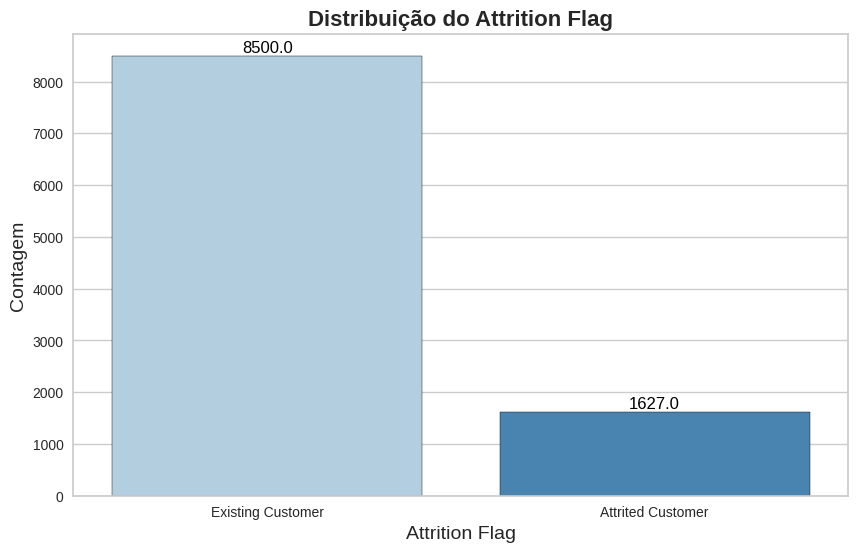

In [ ]:
# Criando o gráfico de contagem
plt.figure(figsize=(10, 6))
sns.countplot(x='Attrition_Flag', data=df, palette='Blues', edgecolor='black')

# Adicionando os valores em cima das barras
for p in plt.gca().patches:
    plt.text(p.get_x() + p.get_width()/2., p.get_height(), str(p.get_height()),
             fontsize=12, color='black', ha="center", va="bottom")

# Adicionando rótulos e título
plt.title('Distribuição do Attrition Flag', fontsize=16, fontweight='bold')
plt.xlabel('Attrition Flag', fontsize=14)
plt.ylabel('Contagem', fontsize=14)


# Exibindo o gráfico
plt.show()

<ipython-input-13-135d21092e67>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Card_Category', y='Credit_Limit', data=credit_limit_mean, palette='viridis')


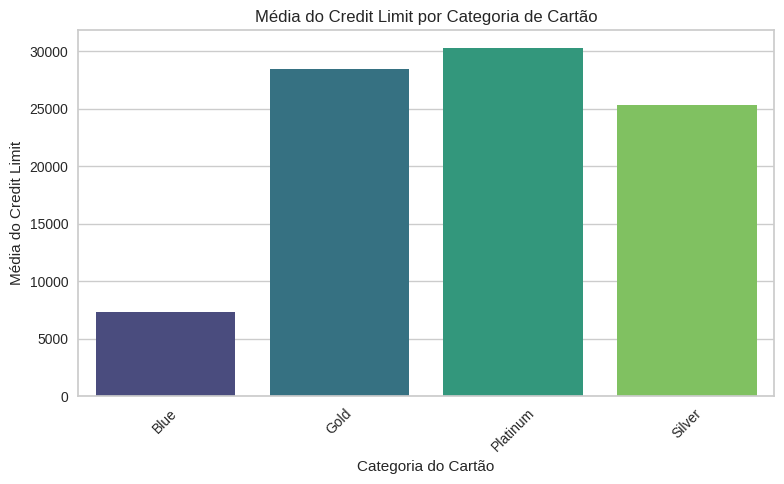

In [ ]:
credit_limit_mean = df.groupby('Card_Category')['Credit_Limit'].mean().reset_index()

# Criando o gráfico
plt.figure(figsize=(8, 5))
sns.barplot(x='Card_Category', y='Credit_Limit', data=credit_limit_mean, palette='viridis')
plt.title('Média do Credit Limit por Categoria de Cartão')
plt.xlabel('Categoria do Cartão')
plt.ylabel('Média do Credit Limit')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

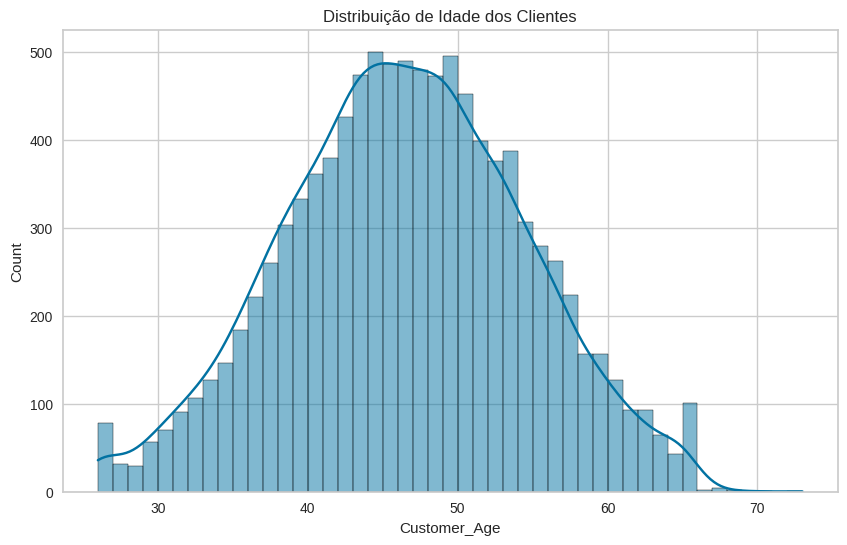

In [ ]:
# Distribuição de idade dos clientes
plt.figure(figsize=(10,6))
sns.histplot(df['Customer_Age'], kde=True)
plt.title('Distribuição de Idade dos Clientes')
plt.show()

# Exploração de Dados com ProfileReport

In [ ]:
profile = ProfileReport(df, title="ExploratoryDataAnalysis")

In [ ]:
profile
profile.to_file("EDA-BankChurners.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile

# Clustering test-2

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as mpatches

In [ ]:
X = df.loc[:, ['Customer_Age', 'Credit_Limit', 'Total_Revolving_Bal',
       'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']].copy()

In [ ]:
X_scaled = StandardScaler().fit_transform(X)

In [ ]:
num_clusters = [i for i in range(2, 10)]

def kmeans_inertia(num_clusters, x_vals):
    inertia = []

    for num in num_clusters:
        kms = KMeans(n_clusters=num, random_state=42, n_init=10)
        kms.fit(x_vals)
        inertia.append(kms.inertia_)

    return inertia


def kmeans_sil(num_clusters, x_vals):
    sil_score = []

    for num in num_clusters:
        kms = KMeans(n_clusters=num, random_state=42, n_init=10)
        kms.fit(x_vals)
        sil_score.append(silhouette_score(x_vals, kms.labels_))

    return sil_score

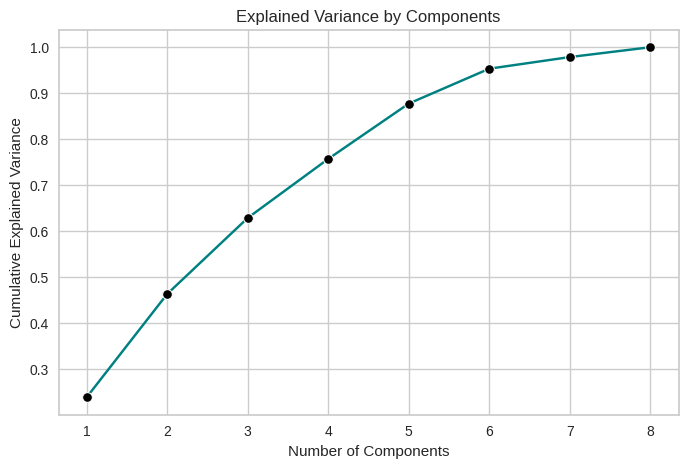

In [ ]:
pca = PCA()
pca.fit(X_scaled)


plt.figure(figsize=(8, 5))
num_components = len(pca.explained_variance_ratio_)
sns.lineplot(x=range(1, num_components + 1), y=pca.explained_variance_ratio_.cumsum(),
             marker='o', color='teal', markerfacecolor='black')
plt.title('Explained Variance by Components')
plt.ylabel('Cumulative Explained Variance')
plt.xlabel('Number of Components')
plt.xticks(range(1, num_components + 1))
plt.grid(True)
plt.show()

In [ ]:
pca = PCA(n_components=3)
pca.fit(X_scaled)
pca.transform(X_scaled)
scores_pca = pca.transform(X_scaled)

In [ ]:
inertia = kmeans_inertia(num_clusters, scores_pca)
sil_score = kmeans_sil(num_clusters, scores_pca)

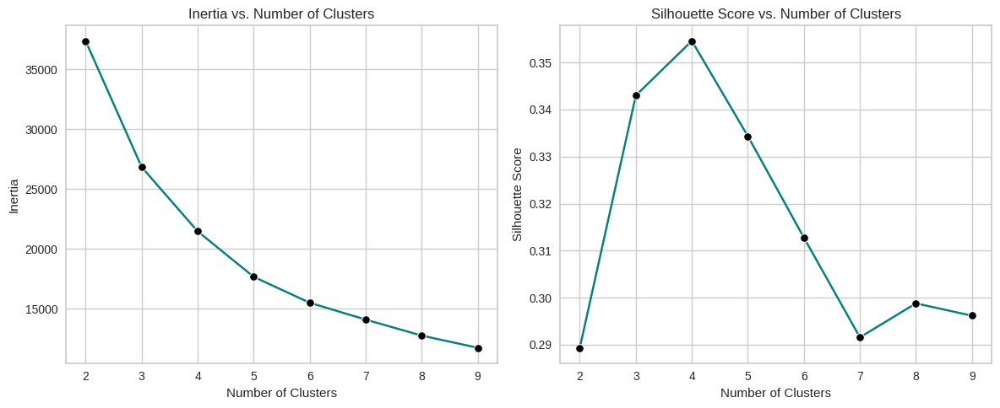

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

sns.lineplot(x=num_clusters, y=inertia, marker='o', ax=ax[0],
             color='teal', markerfacecolor='black')
ax[0].set_title('Inertia vs. Number of Clusters')
ax[0].set_xlabel('Number of Clusters')
ax[0].set_ylabel('Inertia')
ax[0].grid(True)

sns.lineplot(x=num_clusters, y=sil_score, marker='o', ax=ax[1],
             color='teal', markerfacecolor='black')
ax[1].set_title('Silhouette Score vs. Number of Clusters')
ax[1].set_xlabel('Number of Clusters')
ax[1].set_ylabel('Silhouette Score')
ax[1].grid(True)

plt.tight_layout()
plt.show()

In [ ]:
kmeans_pca = KMeans(n_clusters=4, init='k-means++', n_init=10, random_state=42)
kmeans_pca.fit(scores_pca)

df_pca_kmeans = pd.concat([X.reset_index(drop=True), pd.DataFrame(scores_pca)], axis=1)
df_pca_kmeans.columns.values[-3:] = ['PCA1', 'PCA2', 'PCA3']
df_pca_kmeans['Cluster'] = kmeans_pca.labels_

In [ ]:
df_pca_kmeans.head()

,Customer_Age,Credit_Limit,Total_Revolving_Bal,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,PCA1,PCA2,PCA3,Cluster
0,45,0.446622,-0.473422,2.623494,-0.959707,-0.973895,3.834003,-0.775882,-0.030988,0.311938,4.809231,0
1,49,-0.041367,-0.366667,3.563293,-0.916433,-1.357340,12.608573,-0.616276,1.060769,3.004612,10.748598,0
2,51,-0.573698,-1.426858,8.367214,-0.740982,-1.911206,6.807864,-0.997155,0.299824,1.711031,10.671881,0
3,40,-0.585251,1.661686,2.942843,-0.951758,-1.911206,6.807864,1.759686,-0.929619,4.198067,6.227919,0
4,40,-0.430877,-1.426858,6.455682,-1.056263,-1.570365,7.509325,-0.997155,0.393272,1.522256,9.926509,0


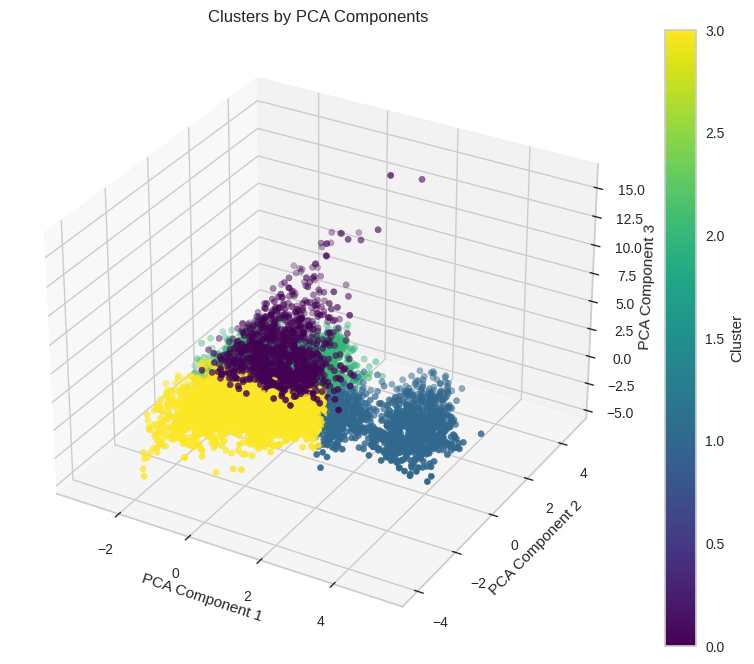

In [ ]:
x_axis = df_pca_kmeans['PCA1']
y_axis = df_pca_kmeans['PCA2']
z_axis = df_pca_kmeans['PCA3']

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(x_axis, y_axis, z_axis, c=df_pca_kmeans['Cluster'], cmap='viridis')
ax.set_xlabel('PCA Component 1')
ax.set_ylabel('PCA Component 2')
ax.set_zlabel('PCA Component 3')
ax.set_title('Clusters by PCA Components')
legend = plt.colorbar(scatter)
legend.set_label('Cluster')
plt.show()

<ipython-input-42-78b3f49da8c2>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_pca_kmeans, x='Cluster', y=column, ax=ax[i], palette='viridis')
<ipython-input-42-78b3f49da8c2>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_pca_kmeans, x='Cluster', y=column, ax=ax[i], palette='viridis')
<ipython-input-42-78b3f49da8c2>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_pca_kmeans, x='Cluster', y=column, ax=ax[i], palette='viridis')
<ipython-input-42-78b3f49da8c2>:9: FutureWarning: 

Passing `palette` without assigning 

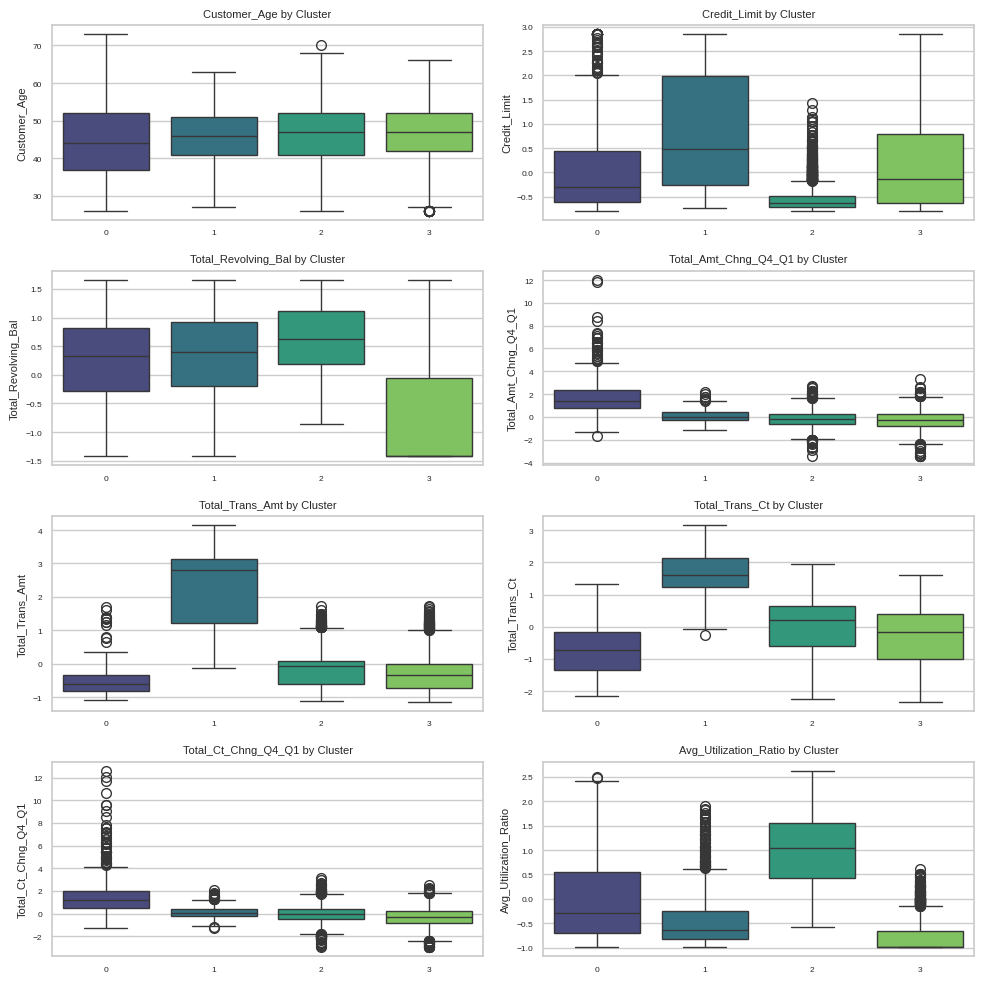

In [ ]:
columns = ['Customer_Age', 'Credit_Limit', 'Total_Revolving_Bal',
           'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt', 'Total_Trans_Ct',
           'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']

fig, ax = plt.subplots(4, 2, figsize=(10, 10))
ax = ax.flatten()

for i, column in enumerate(columns):
    sns.boxplot(data=df_pca_kmeans, x='Cluster', y=column, ax=ax[i], palette='viridis')
    ax[i].set_title(f'{column} by Cluster', fontsize=8)
    ax[i].set_xlabel('')
    ax[i].set_ylabel(column, fontsize=8)
    ax[i].tick_params(axis='both', which='both', labelsize=6)

plt.tight_layout()
plt.show()

<Figure size 800x800 with 0 Axes>

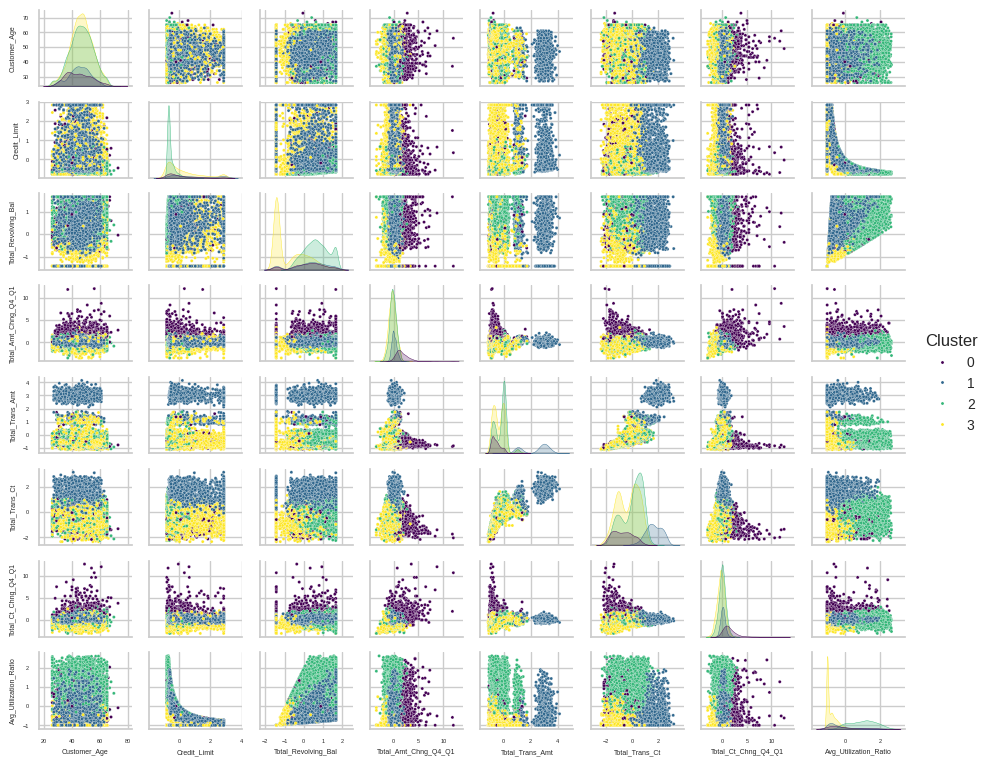

In [ ]:
plt.figure(figsize=(8, 8))
pairplot = sns.pairplot(df_pca_kmeans, vars=columns, hue='Cluster',
                        palette='viridis', plot_kws={'s': 5}, height=1, aspect=1.2)

for ax in pairplot.axes.flat:
    ax.set_xlabel(ax.get_xlabel(), fontsize=5)
    ax.set_ylabel(ax.get_ylabel(), fontsize=5)
    ax.tick_params(labelsize=4)
plt.show()

# Conclusões Resultado Clusterização

---

### **Clusterização Utilizada e Redução de Dimensionalidade**:
A técnica utilizada foi **K-Means**, com **3 clusters** escolhidos após a análise do **método do cotovelo** e da **pontuação de silhueta**. Além disso, a **Análise de Componentes Principais (PCA)** foi aplicada para reduzir a dimensionalidade dos dados e visualizar os clusters em um espaço de 3 dimensões (**PCA1**, **PCA2**, **PCA3**).

---

### **Análise da Clusterização:**

#### 0. **Cluster 0**:
- **Customer_Age**: O Cluster 0 tem uma distribuição de idade um pouco mais velha em comparação com outros clusters, mas com uma faixa ampla (entre 30 e 70 anos).
- **Credit_Limit**: Este cluster possui um limite de crédito relativamente baixo, o que pode indicar que esses clientes são menos favorecidos em termos de crédito concedido.
- **Total_Revolving_Bal**: O saldo rotativo desses clientes é moderado, sugerindo que eles utilizam crédito, mas sem recorrer a grandes valores de saldo devedor.
- **Total_Amt_Chng_Q4_Q1**: A variação de transações entre o quarto trimestre e o primeiro trimestre é alta, indicando que esses clientes podem ter uma variação sazonal significativa no comportamento de gastos.
- **Total_Trans_Amt**: Os valores transacionados são medianos, indicando um nível moderado de gastos com cartões.
- **Total_Trans_Ct**: Eles realizam poucas transações em relação aos outros clusters.
- **Avg_Utilization_Ratio**: Este cluster tem uma taxa de utilização de crédito baixa, sugerindo que seus clientes não utilizam todo o limite de crédito disponível, o que pode indicar uma boa saúde financeira.
  
**Conclusão**: O Cluster 0 engloba clientes de idade intermediária a avançada, com baixo limite de crédito, moderada utilização do cartão e uma variação significativa nas transações trimestrais. Esses clientes parecem ser de baixo risco para a empresa, pois não utilizam todo o seu crédito.

---

#### 1. **Cluster 1**:
- **Customer_Age**: Os clientes desse cluster estão em uma faixa etária intermediária, mais jovem que o Cluster 0.
- **Credit_Limit**: Este grupo tem o maior limite de crédito dentre todos os clusters.
- **Total_Revolving_Bal**: O saldo rotativo deles é menor em relação aos outros grupos, o que sugere que eles não mantêm grandes dívidas com seus cartões.
- **Total_Amt_Chng_Q4_Q1**: Há uma alta variação nas transações, o que sugere um comportamento de gastos dinâmico, talvez com picos em certas épocas do ano.
- **Total_Trans_Amt**: Eles têm os maiores montantes transacionados, indicando que são os clientes que mais gastam.
- **Total_Trans_Ct**: O número de transações também é muito elevado, reforçando o perfil de alto gasto.
- **Avg_Utilization_Ratio**: A taxa de utilização de crédito é baixa, o que sugere que eles têm espaço de sobra em seus limites e não estão perto de esgotá-los.
  
**Conclusão**: O Cluster 1 representa os clientes mais valiosos para a empresa. Eles têm alto limite de crédito, fazem muitas transações, gastam grandes quantias e têm uma utilização conservadora do crédito. Esses clientes provavelmente trazem alta lucratividade e têm baixo risco de inadimplência.

---

#### 2. **Cluster 2**:
- **Customer_Age**: Este cluster tem uma faixa etária ligeiramente mais jovem, variando entre 30 e 60 anos.
- **Credit_Limit**: O limite de crédito é moderado, menor do que o do Cluster 1, mas maior do que o do Cluster 0.
- **Total_Revolving_Bal**: Esses clientes têm um saldo rotativo maior, sugerindo que dependem mais do crédito rotativo.
- **Total_Amt_Chng_Q4_Q1**: A variação das transações ao longo dos trimestres é menor do que nos outros clusters.
- **Total_Trans_Amt**: Os valores transacionados são menores do que no Cluster 1, mas ainda substanciais.
- **Total_Trans_Ct**: O número de transações é elevado, indicando que esses clientes são engajados e utilizam o cartão com frequência.
- **Avg_Utilization_Ratio**: Este cluster tem uma taxa de utilização de crédito mais alta, indicando que esses clientes estão mais próximos de atingir seus limites de crédito.
  
**Conclusão**: O Cluster 2 compreende clientes que utilizam de maneira mais ativa seus limites de crédito. Eles fazem muitas transações, mas têm um risco mais elevado de inadimplência, já que a taxa de utilização do crédito é alta. Esses clientes podem necessitar de atenção para gerenciamento de crédito.

---

#### 3. **Cluster 3**:
- **Customer_Age**: O Cluster 3 abrange uma faixa etária similar à do Cluster 2, com clientes mais jovens.
- **Credit_Limit**: Eles têm um limite de crédito relativamente alto, próximo ao do Cluster 1.
- **Total_Revolving_Bal**: O saldo rotativo é baixo, indicando que eles não utilizam muito crédito rotativo.
- **Total_Amt_Chng_Q4_Q1**: A variação nas transações ao longo dos trimestres é baixa.
- **Total_Trans_Amt**: Eles transacionam menos do que os clientes do Cluster 1, mas ainda em valores razoáveis.
- **Total_Trans_Ct**: O número de transações é menor em comparação com os outros clusters.
- **Avg_Utilization_Ratio**: A taxa de utilização de crédito é moderada, indicando que esses clientes usam o crédito, mas não em excesso.
  
**Conclusão**: O Cluster 3 inclui clientes que têm um comportamento financeiro equilibrado, com um bom limite de crédito e uma utilização moderada. Eles não são tão ativos quanto os clientes do Cluster 1, mas ainda são valiosos para a empresa, pois têm um perfil de risco moderado.

---

### **Resumo dos Grupos de Clientes**:
- **Cluster 0**: Clientes de idade intermediária a avançada, com limite de crédito baixo e uma variação significativa nos gastos ao longo dos trimestres. Eles parecem ser de baixo risco e utilizam moderadamente o crédito.
- **Cluster 1**: Clientes valiosos, com altos limites de crédito, muitas transações e uma baixa utilização de crédito, o que sugere boa saúde financeira. Esses são os melhores clientes da empresa.
- **Cluster 2**: Clientes que utilizam ativamente seus limites de crédito, fazem muitas transações e têm um risco maior de inadimplência. Eles podem ser bons alvos para monitoramento de crédito.
- **Cluster 3**: Clientes com comportamento equilibrado, limite de crédito alto, mas menos ativos do que o Cluster 1. Eles também são de baixo a moderado risco, com uma utilização moderada de crédito.

Esses insights podem ajudar a definir **estratégias de retenção** e **oferta de produtos personalizados** para cada grupo, maximizando a lucratividade e reduzindo o risco de churn.
